In [1]:
from PIL import Image

def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [7]:
import torch
from diffusers import DiffusionPipeline

cd_pipe = DiffusionPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16
).to("cuda")
cd_pipe.unet.load_attn_procs(
    "./saved_models_boy", weight_name="pytorch_custom_diffusion_weights.bin"
)
cd_pipe.load_textual_inversion("saved_models_boy", weight_name="<new2>.bin")

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/100 [00:00<?, ?it/s]

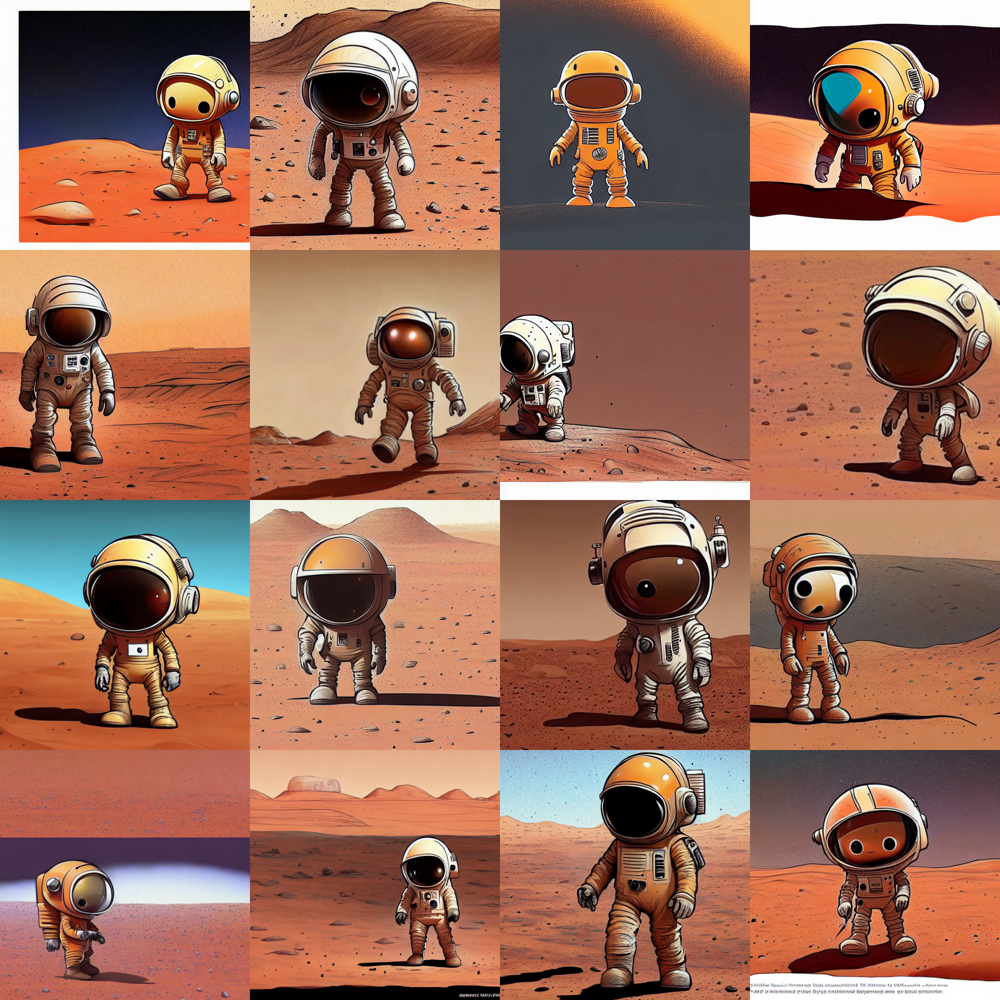

In [8]:
results = cd_pipe(
    "<new2> cartoon character lived on Mars, the red planet.",
    num_inference_steps=100,
    guidance_scale=6.0,
    eta=1.0,
    num_images_per_prompt=16,
)

image_grid(results.images, 4, 4)

In [11]:
images = results.images
images

[<PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>,
 <PIL.Image.Image image mode=RGB size=512x512>]

In [ ]:
del results
torch.cuda.empty_cache()

In [36]:
del pipe
torch.cuda.empty_cache()

In [9]:
type(results)

diffusers.pipelines.stable_diffusion.StableDiffusionPipelineOutput

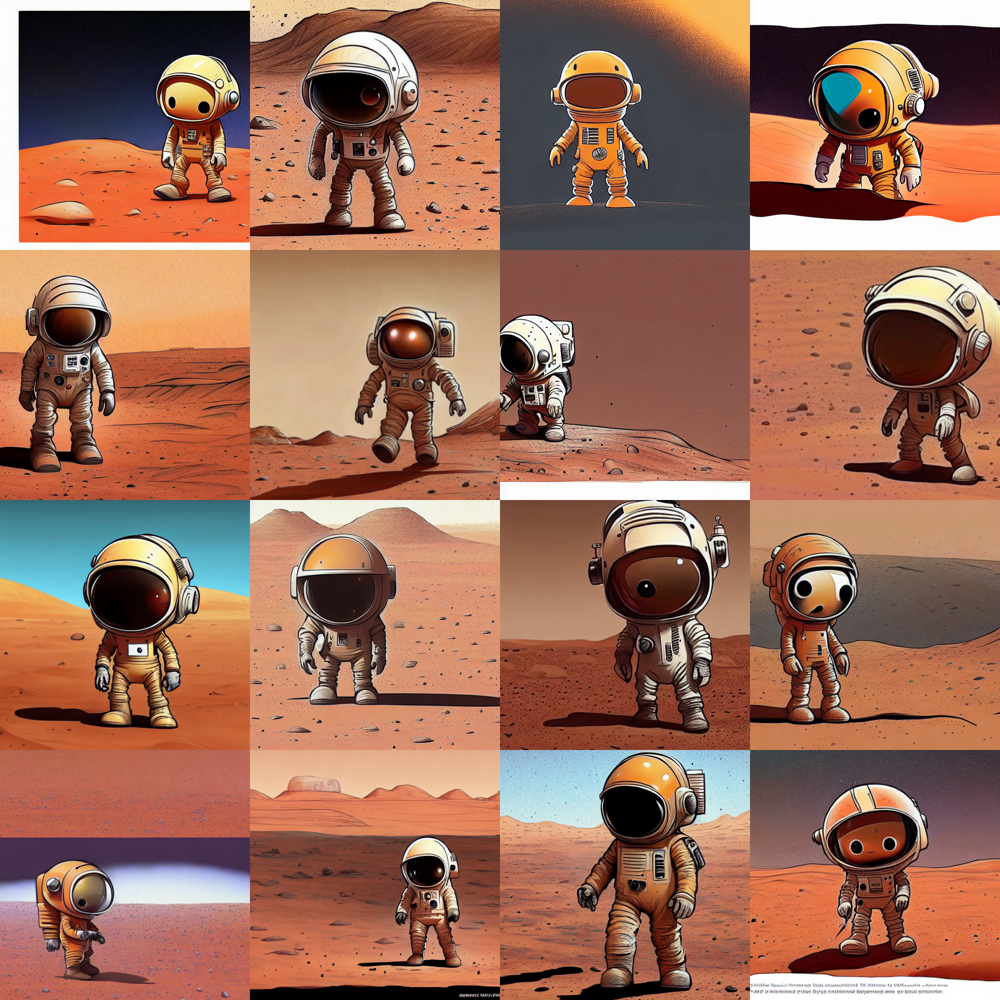

In [15]:
image_grid(images, 4, 4)

In [ ]:
import clip_similarity

cs = clip_similarity.CreateClipSimilarity()

In [28]:
for img1 in images[:4]:
    for img2 in images[:4]:
        print(cs.image_similarity(img1, img2))

1.0
0.8811
0.8461
0.8987
0.8811
1.0
0.8613
0.9154
0.8461
0.8613
1.0
0.8646
0.8987
0.9154
0.8646
1.0


In [24]:
import os

orig_images_dir = 'data/cartoon_boy/'
orig_images = []

for f in os.listdir(orig_images_dir):
    if f.endswith('png') or f.endswith('jpeg'):
        orig_images.append(Image.open(os.path.join(orig_images_dir, f)))

orig_images

[<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=512x512>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=512x512>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=512x512>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGBA size=512x512>]

In [34]:
from itertools import product
import numpy as np

sim_scores = []
for orig, gen in product(orig_images, images):
    sim_scores.append(cs.image_similarity(orig, gen))
print(sim_scores, len(sim_scores))
print(np.array(sim_scores).mean())

[0.7819, 0.8011, 0.8241, 0.8041, 0.7882, 0.821, 0.8127, 0.7923, 0.8011, 0.7943, 0.7672, 0.7871, 0.7852, 0.7496, 0.7853, 0.7858, 0.7507, 0.7482, 0.799, 0.7562, 0.7359, 0.7325, 0.7448, 0.7327, 0.7235, 0.7524, 0.721, 0.7435, 0.7338, 0.6831, 0.7525, 0.7414, 0.7504, 0.724, 0.7784, 0.7188, 0.7213, 0.7309, 0.727, 0.7057, 0.7177, 0.7231, 0.7042, 0.7354, 0.7206, 0.658, 0.7179, 0.7397, 0.7749, 0.7894, 0.8016, 0.7928, 0.7718, 0.7983, 0.796, 0.7748, 0.784, 0.7857, 0.7563, 0.7776, 0.7631, 0.7297, 0.7712, 0.78] 64
0.7586328125


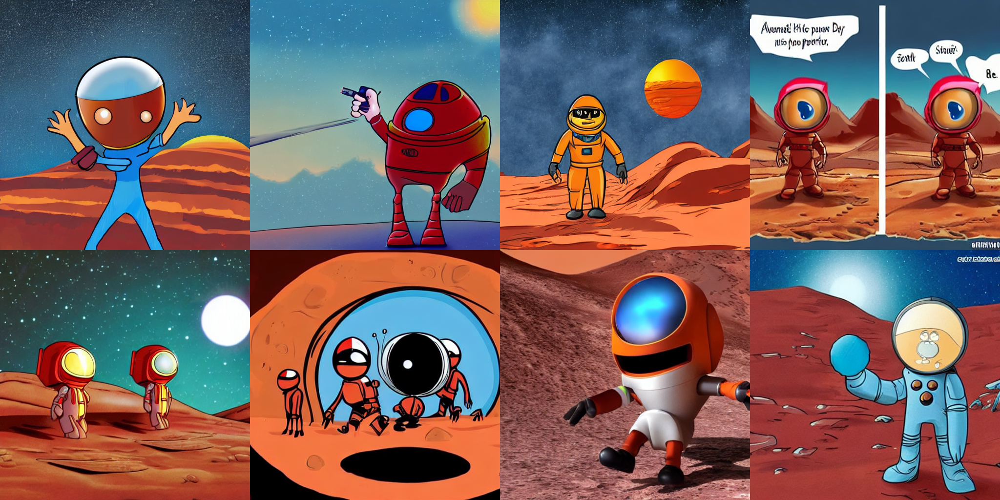

In [41]:
image_grid(res.images, 2, 4)

In [49]:
from diffusers import StableDiffusionImg2ImgPipeline

pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    revision="fp16",
    torch_dtype=torch.float16,
).to("cuda")

text_encoder/model.safetensors not found
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
/home/victor/miniconda3/envs/cd/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [70]:
res = pipe(
    prompt='cartoon character lived on Mars, the red planet.',
    image=orig_images[0].convert("RGB"),
    guidance_scale=6,
    num_inference_steps=100,
    eta=1.0,
    strength=0.8,
    num_images_per_prompt=10,
)

  0%|          | 0/80 [00:00<?, ?it/s]

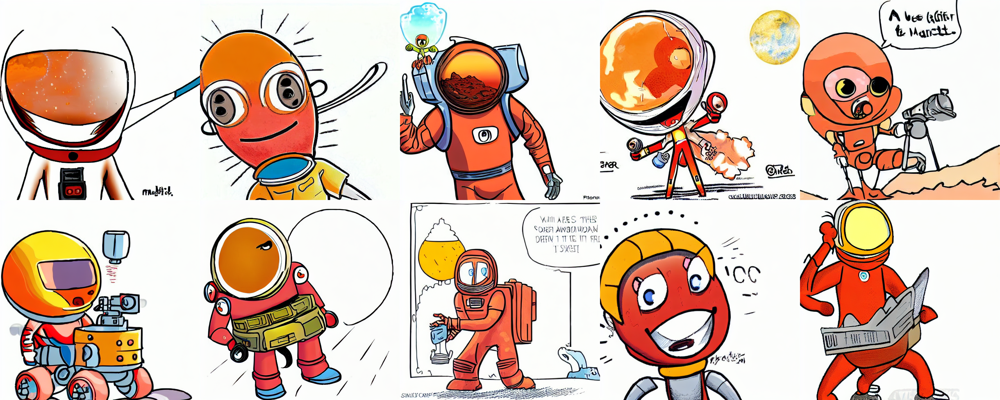

In [71]:
image_grid(res.images, 2, 5)

In [ ]:
del res
torch.cuda.empty_cache()

In [72]:
sim_scores = []
for (org, gen) in product(orig_images, res.images):
    sim_scores.append(cs.image_similarity(org, gen))
print(np.array(sim_scores).mean())

0.693485


In [75]:
text_sim_scores = []
for gen in res.images:
    text_sim_scores.append(cs.text_image_similiarity('cartoon character lived on Mars, the red planet.', gen))
print(np.array(text_sim_scores).mean())

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will

25.18773
